# Lab 07 - Data Preprocessing II

Name: Jake Schaeffer  
Class: CSCI 349 - Intro to Data Mining  
Semester: Spring 2020  
Instructor: Brian King

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

#### **1)** [P] Create a Python function called process_FAA_hourly_data that takes a filename (with path) as a string, and returns a completely processed pandas data frame, ready for analysis. It should do everything that the previous lab did to clean the file, including  
a. converting all numeric variables to their simplest numeric types  
b. converting the date/time stamp (first variable) to a pandas DatetimeIndex, which becomes the
actual index for the data frame. (It should drop the date time variable after moving it to become the
index.)  
c. If you did not do this in the last lab, make sure that the DatetimeIndex is localized to a specific
timezone! This is very important! What time zone? Did you notice the header? The time stamp is in
GMT, so be sure to localize the index accordingly. HOW? After you set up the index, you can do:
df.index = df.index.tz_localize(tz='GMT')  
NOTE: The last exercise in the previous lab had you eliminate a year from the data for the very last
problem. Do NOT do that here! We'll explore that again later.

In [4]:
def process_FAA_hourly_data(fileName): #takes in filepath and returns processed data frame
    df = pd.read_csv(fileName,skiprows = 16) #read in file
    df.drop(df.columns[-1],axis = 1,inplace = True) # remove last column
    df = df[df[df.columns[0]] != df.columns[0]] #remove duplicate label rows
    df = df.reset_index(drop = True) #reset index after removing duplicate rows
    df[df.columns[1]] = df[df.columns[1]].apply(pd.to_numeric,downcast = "integer") #convert ints to numeric
    df[df.columns[2:]] = df[df.columns[2:]].apply(pd.to_numeric,downcast = "float") #convert floats to numeric
    df[df.columns[0]] = pd.to_datetime(df[df.columns[0]]).dt.tz_localize("GMT") #convert dates to dates
    df = df.set_index(df[df.columns[0]]) #set datess to be index
    df = df.drop(df.columns[0], axis = 1) # drop dates column
    return df

#### **2)** [P] Use your new function to read in the KIPT data file you downloaded in the last lab. Store your data frame as df_kipt. Output the results of info() and describe() to confirm you read it in correctly.

In [5]:
df_kipt = process_FAA_hourly_data("../data/faa_hourly-KIPT_20000101-20191231_raw.csv")
print(df_kipt.info())
df_kipt.describe()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 173252 entries, 2000-01-01 00:00:00+00:00 to 2019-12-31 23:00:00+00:00
Data columns (total 12 columns):
Number of Observations (n/a)     173252 non-null int64
Average Temp (F)                 172253 non-null float32
Max Temp (F)                     172253 non-null float32
Min Temp (F)                     172253 non-null float32
Average Dewpoint Temp (F)        172147 non-null float32
1 Hour Precip (in)               28934 non-null float32
Max Wind Gust (mph)              23544 non-null float32
Average Relative Humidity (%)    168754 non-null float32
Average Wind Speed (mph)         172710 non-null float32
Average Station Pressure (mb)    172974 non-null float32
Average Wind Direction (deg)     140590 non-null float32
Max Wind Speed (mph)             172710 non-null float32
dtypes: float32(11), int64(1)
memory usage: 9.9 MB
None


,Number of Observations (n/a),Average Temp (F),Max Temp (F),Min Temp (F),Average Dewpoint Temp (F),1 Hour Precip (in),Max Wind Gust (mph),Average Relative Humidity (%),Average Wind Speed (mph),Average Station Pressure (mb),Average Wind Direction (deg),Max Wind Speed (mph)
count,173252.000000,172253.000000,172253.000000,172253.000000,172147.000000,28934.000000,23544.000000,168754.000000,172710.000000,172974.000000,140590.000000,172710.000000
mean,1.339915,51.286217,51.399208,51.179626,40.253628,0.030566,22.295341,68.819511,5.904806,1016.741272,176.806366,6.175715
std,0.854852,18.888988,18.907930,18.881851,19.053423,0.079247,7.581788,19.694031,5.192565,7.640043,118.790619,5.311181
min,0.000000,-11.900000,-11.900000,-11.900000,-20.900000,0.000000,0.000000,0.000000,0.000000,508.600006,0.000000,0.000000
25%,1.000000,36.000000,36.000000,36.000000,25.830000,0.000000,19.600000,54.000000,0.000000,1012.200012,70.000000,0.000000
50%,1.000000,52.000000,52.000000,51.799999,41.000000,0.000000,21.900000,71.000000,5.370000,1016.900024,220.000000,5.800000
75%,1.000000,66.900002,66.900002,66.900002,57.000000,0.030000,26.500000,86.000000,9.200000,1021.700012,280.000000,9.200000
max,10.000000,102.000000,102.000000,102.000000,79.000000,2.350000,88.599998,100.000000,76.000000,1044.400024,360.000000,76.000000


#### 3) [P] In the last lab, you assessed the number of missing dates in your data, under the assumption that every hour should have an observation. For now, we'll leave the fact that there are completely missing hourly observations from the weather station. This time, report the number of missing values in each variable of df_kipt. 
(HINT: One way is to use the isna() method.)

In [6]:
df_kipt.isna().sum()

Number of Observations (n/a)          0
Average Temp (F)                    999
Max Temp (F)                        999
Min Temp (F)                        999
Average Dewpoint Temp (F)          1105
1 Hour Precip (in)               144318
Max Wind Gust (mph)              149708
Average Relative Humidity (%)      4498
Average Wind Speed (mph)            542
Average Station Pressure (mb)       278
Average Wind Direction (deg)      32662
Max Wind Speed (mph)                542
dtype: int64

#### 4) [M] Which variables seem to have the most consistent, complete observations? Which are missing the most?
Are they really "missing", or are they observations where an event did not occur? Discuss.

wind speed and pressure were the most consistent. Temperature was consistent as well. This is likely because they are easy to read and will usually have a significant value. Precipitation and wind gusts were missing the most, as well as wind direction. These are likely not missing, but there was no good observation to put. For instance, there was no wind direction because it was going in every direction. There was never a gust to record a max wind gust. If it didn't rain, instead of putting 0 inches precipitation it may have just been left blank. Humidity and dewpoint may not have been recorded when it was really dry because there was no dew/humidity.

#### 5) [P/M] Ignore the date, and report the frequency over hours that have missing "Average Temp (F)"values.
Be sure to report the LOCAL times according to the time zone "US/Eastern". Output the hours in
order of the most frequent to least. Then, as a comment, just interpret what you see. Do you see a pattern?
Do missing temps tend to happen at a certain time of day?
(HINT: This might be challenging. First, as always, select the subset of your data matching your criteria. Then,
for these data, look at the index. Date / time values have LOTS of attributes themselves... such as hour.
What do you get if you count these values?)

In [7]:
# Select your data
sel = df_kipt.loc[:,"Average Temp (F)"].isnull()
#we groupby hour summing how many trues we have, then sort
sel.groupby(sel.index.hour).sum().sort_values(ascending = False)

Date/Time (GMT)
15    73.0
16    65.0
17    64.0
14    58.0
18    47.0
19    42.0
10    40.0
11    40.0
13    39.0
20    38.0
12    38.0
21    38.0
9     38.0
8     37.0
7     37.0
5     35.0
4     35.0
23    35.0
6     35.0
22    35.0
2     34.0
3     33.0
0     32.0
1     31.0
Name: Average Temp (F), dtype: float64

10am to 7pm have the most missing values. This is notable because it is the afternoon and also likely the time the most people are around.

### 6) [P/M] Repeat the previous exercise, but this time, assess the same variable for the day of the week. (NOTE: Be sure to note what a 0 is. In pandas, a 0 for day of the week is a Monday!

In [8]:
# Select your data
sel = df_kipt.loc[:,"Average Temp (F)"].isnull()
#we groupby hour summing how many trues we have, then sort
sel.groupby(sel.index.dayofweek).sum().sort_values(ascending = False)
#I want to do this with resample but i couldnt figure out how
#sel.resample("H").count()

Date/Time (GMT)
1    215.0
2    196.0
3    159.0
0    153.0
4    137.0
6    105.0
5     34.0
Name: Average Temp (F), dtype: float64

there are more missing values earlier in the week

### 7) [P] Read in the file FAA_PA_stations.csv provided on Moodle. It's not actually a comma separated file, but a tab separated file. Store the data frame as stations. Show stations.info() after you read in the data.

In [9]:
stations = pd.read_csv("../data/FAA_PA_stations.csv",sep = "\t")
stations.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 46 entries, 0 to 45
Data columns (total 7 columns):
ID                  46 non-null object
Name                46 non-null object
County              45 non-null object
State               46 non-null object
Lat                 46 non-null float64
Lon                 46 non-null float64
Elevation (feet)    46 non-null float64
dtypes: float64(3), object(4)
memory usage: 2.6+ KB


### 8) [P] As usual, you must always assess your missing data, if any. Are there any observations (rows) in stations that have missing data? Output them, and eliminate them from your data. Be sure to reset_index(drop=True) to reset the index in case any observations are dropped. Output stations.info() again.

In [10]:
print(stations[stations.County.isna() == True])
stations.dropna().reset_index(drop = True, inplace = True)

      ID            Name County State     Lat     Lon  Elevation (feet)
24  KUKT  QUAKERTOWN ARP    NaN    PA  40.435 -75.381             524.9


### 9) [P] Examine the data frame of stations by showing the first few observations using stations.head(10) In particular, pay close attention to the variables Lat and Lon. These represent the precise latitude and longitude geolocation for the weather station.

In [11]:
stations.head(10)

,ID,Name,County,State,Lat,Lon,Elevation (feet)
0,KABE,ALLENTOWN,LEHIGH,PA,40.65,-75.44,376.0
1,KAOO,ALTOONA,BLAIR,PA,40.29,-78.32,1504.0
2,KBVI,BEAVER FALLS,BEAVER,PA,40.77,-80.39,1230.0
3,KBFD,BRADFORD,MCKEAN,PA,41.80,-78.64,2142.0
4,KBTP,BUTLER,BUTLER,PA,40.77,-79.95,1250.0
5,KCXY,CAPITAL CITY,YORK,PA,40.22,-76.85,340.0
6,KFIG,CLEARFIELD,CLEARFIELD,PA,41.04,-78.41,1516.0
7,KDYL,DOYLESTOWN,BUCKS,PA,40.33,-75.12,394.0
8,KDUJ,DUBOIS,JEFFERSON,PA,41.18,-78.90,1814.0
9,KERI,ERIE,ERIE,PA,42.08,-80.17,730.0


### 10) Create a new variable in stations called "distKIPT" that stores the distance of every station in PA toWilliamsport (KIPT). Use a standard Euclidean distance calculation (over latitude and longitude) to computethe distance between the stations. As a reminder, Euclidean distance between two points defined by (x1, y1) and (x2, y2) is:

In [12]:
lon = stations["Lon"]  
lat = stations["Lat"] 
#d4istKPT = sqrt()
lonKIPT = stations[stations.ID =="KIPT"].Lon.iloc[0]
latKIPT = stations[stations.ID == "KIPT"].Lat.iloc[0]


stations["distKIPT"] = (np.sqrt(np.square(lon - lonKIPT) + np.square(lat - latKIPT)))
stations.head()

,ID,Name,County,State,Lat,Lon,Elevation (feet),distKIPT
0,KABE,ALLENTOWN,LEHIGH,PA,40.65,-75.44,376.0,1.593267
1,KAOO,ALTOONA,BLAIR,PA,40.29,-78.32,1504.0,1.691892
2,KBVI,BEAVER FALLS,BEAVER,PA,40.77,-80.39,1230.0,3.501685
3,KBFD,BRADFORD,MCKEAN,PA,41.80,-78.64,2142.0,1.808867
4,KBTP,BUTLER,BUTLER,PA,40.77,-79.95,1250.0,3.066235


### 11) [P] Output the top 10 stations that are closest to KIPT. (The closest one should be to itself!) The stations should be listed in order of increasing distance from KIPT.

In [13]:
stations.sort_values(by = "distKIPT").head(10)

,ID,Name,County,State,Lat,Lon,Elevation (feet),distKIPT
30,KIPT,WILLIAMSPORT,LYCOMING,PA,41.24,-76.92,520.0,0.000000
27,KSEG,SELINSGROVE,SNYDER,PA,40.82,-76.86,444.0,0.424264
18,KMUI,MUIR ARMY AIR FIELD,LEBANON,PA,40.43,-76.57,489.0,0.882383
28,KUNV,UNIVERSITY PARK,CENTRE,PA,40.85,-77.85,1240.0,1.008464
5,KCXY,CAPITAL CITY,YORK,PA,40.22,-76.85,340.0,1.022399
16,KMDT,MIDDLETOWN,DAUPHIN,PA,40.19,-76.76,312.0,1.062121
26,KAVP,SCRANTON,LUZERNE,PA,41.33,-75.72,956.0,1.203370
13,KLNS,LANCASTER,LANCASTER,PA,40.12,-76.29,403.0,1.285029
25,KRDG,READING,BERKS,PA,40.37,-75.96,360.0,1.295569
32,KTHV,YORK,YORK,PA,39.92,-76.87,486.0,1.320947


### 12) [P] Using your results, go back to the PSU climate website ( http://climate.met.psu.edu/data/ida/ ), and download the faa_hourly data for the THREE closest stations that have hourly data available in the same date range as the data you downloaded from KIPT (i.e. 2000-01-01 à 2019-12-31). 
(HINT: You may need to skip a
station because it does not have data available in this range.) Copy the data into your data folder. Then, read
in each data file into its own data frame using your function. You should have four data frames: df_kipt,
and three other data frames representing the three closest stations. Show the result of info() on your three
new data frames.
(HINT: KSEG, KUNV, KCXY)
You're going to repair our KIPT data, but how? Since we have data from nearby stations with independent
readings, let's see how many of our missing data can be filled in from a nearby station. Again, for simplicity, we're
only going to focus on average temperature (column 1).
As an advanced CS elective, you should be going for efficient, clean code. It need not be perfect, but it should be
well-thought out and documented so you can readily show it to prospective employers, and also use it later!
Remember - you are going to start doing more advanced analyses very soon! So, when your code or your output is
not obvious or intuitive, write markdown after your output is generated that explains your code, and interprets
your results!

In [14]:
df_kunv = process_FAA_hourly_data("../data/faa_hourly-KUNV_20000101-20191231_raw.csv")
df_kcxy = process_FAA_hourly_data("../data/faa_hourly-KCXY_20000101-20191231_raw.csv")
df_kseg = process_FAA_hourly_data("../data/faa_hourly-KSEG_20000101-20191231_raw.csv")
print(df_kunv.info())
print(df_kcxy.info())
print(df_kseg.info())

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 168630 entries, 2000-01-01 00:00:00+00:00 to 2019-12-31 23:00:00+00:00
Data columns (total 12 columns):
Number of Observations (n/a)     168630 non-null int64
Average Temp (F)                 167310 non-null float32
Max Temp (F)                     167310 non-null float32
Min Temp (F)                     167310 non-null float32
Average Dewpoint Temp (F)        167299 non-null float32
1 Hour Precip (in)               7505 non-null float32
Max Wind Gust (mph)              32070 non-null float32
Average Relative Humidity (%)    162847 non-null float32
Average Wind Speed (mph)         168298 non-null float32
Average Station Pressure (mb)    167219 non-null float32
Average Wind Direction (deg)     151713 non-null float32
Max Wind Speed (mph)             168298 non-null float32
dtypes: float32(11), int64(1)
memory usage: 9.6 MB
None
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 127229 entries, 2000-01-01 00:00:00+00:00 to 2019-12-31

### 13) [P] Create a new data frame called df_ave_temps that contains the average temperature from all four stations. 
Name the variables with the four-letter station identifier (e.g. "KIPT"). The index should have a COMPLETE hourly date range from the start date "20000101 00:00:00 GMT" to finish date "20191231 23:00:00 GMT". The results should be a complete dataset with an observation for every
hour. If hourly observations are missing from the station you are copying from, then a NaN value should be
stored for that entry. You will use these data for the remainder of this exercise.

Show df_ave_temps.info()

In [15]:
times = pd.date_range("20000101 00:00:00 GMT","20191231 23:00:00 GMT", freq = "H")
aveTempStr = df_kipt.columns[1]
df_ave_temps = pd.DataFrame({"KIPT":df_kipt[aveTempStr],"KUNV":df_kunv[aveTempStr],"KSEG":df_kseg[aveTempStr],"KCXY":df_kcxy[aveTempStr]},times)
df_ave_temps.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 175320 entries, 2000-01-01 00:00:00+00:00 to 2019-12-31 23:00:00+00:00
Freq: H
Data columns (total 4 columns):
KIPT    172253 non-null float32
KUNV    167310 non-null float32
KSEG    171579 non-null float32
KCXY    126767 non-null float32
dtypes: float32(4)
memory usage: 4.0 MB


### 14) [P] Report the number of observations in df_ave_temps that have missing temps for each location. You should output a DataFrame or Series that shows four values.

In [16]:
df_ave_temps.isna().sum()

KIPT     3067
KUNV     8010
KSEG     3741
KCXY    48553
dtype: int64

### 15) [P] Report the number of missing data in KIPT that have at least one alternative station with an existing value.
You should output a statement like, "There are XXXX out of XXXX values in KIPT that
can be restored from other locations." Also, show the first 10 observations of these data
that meet this criteria using head(10).

In [17]:
ipt = df_ave_temps["KIPT"]
unv = df_ave_temps["KUNV"]
seg = df_ave_temps["KSEG"]
cxy = df_ave_temps["KCXY"]

alts = df_ave_temps[(ipt.isna()) & ((unv.notna()) | (seg.notna()) | (cxy.notna()))]
val = len(alts)
outof = ipt.isna().sum()
print("There are {} out of {} values in KIPT that can be restored from other locations.".format(val,outof))
alts.head(10)

There are 1847 out of 3067 values in KIPT that can be restored from other locations.


,KIPT,KUNV,KSEG,KCXY
2000-01-03 18:00:00+00:00,NaN,57.200001,53.099998,NaN
2000-01-05 17:00:00+00:00,NaN,32.000000,35.099998,NaN
2000-01-06 20:00:00+00:00,NaN,39.200001,41.000000,NaN
2000-01-07 14:00:00+00:00,NaN,35.599998,36.000000,35.599998
2000-01-10 02:00:00+00:00,NaN,37.400002,39.000000,NaN
2000-01-10 03:00:00+00:00,NaN,35.599998,39.000000,NaN
2000-01-10 04:00:00+00:00,NaN,NaN,36.000000,NaN
2000-01-10 05:00:00+00:00,NaN,NaN,32.000000,NaN
2000-01-10 06:00:00+00:00,NaN,NaN,34.000000,NaN
2000-01-10 07:00:00+00:00,NaN,NaN,35.349998,NaN


### 16) [P] Remember that exercise in the previous lab that gathered the number of missing data by year? Report the number of missing data in KIPT by year that CANNOT be restored from any of the other stations. What year is standing out as the least likely to be successfully restored?

In [18]:
# if all vals are nan for the row we are SOL
noAlts = df_ave_temps[(ipt.isna()) & (unv.isna()) &(seg.isna()) &(cxy.isna())]
SOLdates=noAlts.fillna(1).resample("Y").count()["KIPT"]
SOLdates
#2000 isn't looking too good
#thank you to Zara for advice of using fillna()

2000-12-31 00:00:00+00:00    739
2001-12-31 00:00:00+00:00     13
2002-12-31 00:00:00+00:00      4
2003-12-31 00:00:00+00:00     15
2004-12-31 00:00:00+00:00      7
2005-12-31 00:00:00+00:00      7
2006-12-31 00:00:00+00:00      6
2007-12-31 00:00:00+00:00     34
2008-12-31 00:00:00+00:00    109
2009-12-31 00:00:00+00:00     24
2010-12-31 00:00:00+00:00     10
2011-12-31 00:00:00+00:00     13
2012-12-31 00:00:00+00:00     41
2013-12-31 00:00:00+00:00     28
2014-12-31 00:00:00+00:00     11
2015-12-31 00:00:00+00:00     27
2016-12-31 00:00:00+00:00      8
2017-12-31 00:00:00+00:00     61
2018-12-31 00:00:00+00:00     44
2019-12-31 00:00:00+00:00     19
Freq: A-DEC, Name: KIPT, dtype: int64

### 17) [P] It still looks like one year in particular is pretty bad. Confirm this visually by creating a line plot that plots all four stations for that one year, with each station a different color. Make sure KIPT stands out in some way. Only show the data for that one year you answered in the previous exercise. Interpret your results. In particular, do you see any other problems from any stations? (This might be a good time to use an interactive data visualization tool such as Plotly!) Label your plot (e.g. title, axis, legend)

With the proper interactive data visualization tool, you can easily search through your data for problems.
Zooming in on problems can help you develop the additional logic you need in order to clean your data. For
example:

The above graph shows an interesting problem on April 10, 2000. It's not a missing value, but it's a problem,
and these problems can have an impact on your data you use for EDA, summary statistics, and modeling.

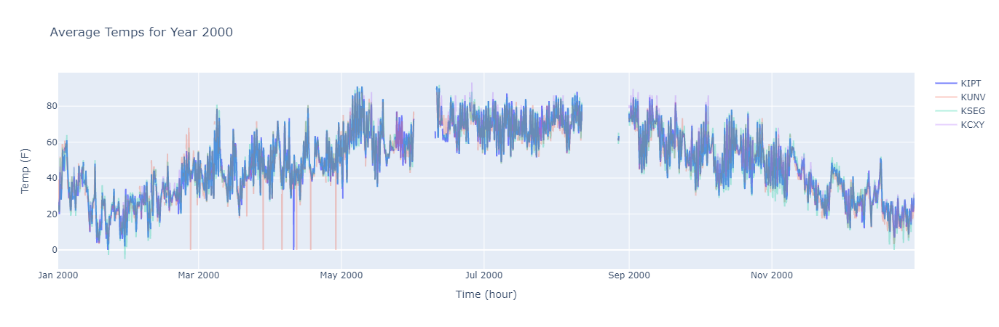

In [30]:
import plotly.express as px
#get year with most missing
yearWeWant = SOLdates.idxmax().year
# get indices of all rows in that year
indicesToEliminate = df_ave_temps[df_ave_temps.index.year != yearWeWant].index
dfToPlot = df_ave_temps.drop(indicesToEliminate)

#zara helped me again
import plotly.graph_objects as go
fig = go.Figure()
fig.add_trace(go.Scatter(x=dfToPlot.index,y=dfToPlot["KIPT"],name = "KIPT", opacity = .9))
fig.add_trace(go.Scatter(x=dfToPlot.index,y=dfToPlot["KUNV"],name = "KUNV", opacity = .3))
fig.add_trace(go.Scatter(x=dfToPlot.index,y=dfToPlot["KSEG"],name = "KSEG", opacity = .3))
fig.add_trace(go.Scatter(x=dfToPlot.index,y=dfToPlot["KCXY"],name = "KCXY", opacity = .3))
fig.update_layout(title_text = "Average Temps for Year 2000",
                  xaxis_title = "Time (hour)",
                  yaxis_title = "Temp (F)")
fig.show()

### 18) [P] Looking at your plot of 2000 over all stations should reveal that KUNV is problematic at 6 different times.
Report these observations, but report them from your full KUNV dataframe. Show only those observations.

In [19]:
df_kunv.where(df_kunv[aveTempStr] == 0).dropna(how = "all")

,Number of Observations (n/a),Average Temp (F),Max Temp (F),Min Temp (F),Average Dewpoint Temp (F),1 Hour Precip (in),Max Wind Gust (mph),Average Relative Humidity (%),Average Wind Speed (mph),Average Station Pressure (mb),Average Wind Direction (deg),Max Wind Speed (mph)
Date/Time (GMT),,,,,,,,,,,,
2000-02-26 13:00:00+00:00,1.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,8.100000,0.000000,NaN,8.100000
2000-03-28 14:00:00+00:00,1.0,0.0,0.0,0.0,26.600000,0.0,20.799999,0.0,13.900000,990.900024,NaN,13.900000
2000-04-05 14:00:00+00:00,1.0,0.0,0.0,0.0,0.000000,0.0,26.299999,0.0,20.799999,0.000000,NaN,20.799999
2000-04-11 22:00:00+00:00,1.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,5.800000,0.000000,NaN,5.800000
2000-04-17 21:00:00+00:00,1.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,8.100000,0.000000,NaN,8.100000
2000-04-28 15:00:00+00:00,1.0,0.0,0.0,0.0,35.599998,0.0,0.000000,0.0,9.200000,1013.900024,NaN,9.200000


### 19) [M] How could you algorithmically detect those problems? Keep in mind that simply saying to turn 0.0 into NaN is not an acceptable solution. 0.0 may very well be a real value!

By having a limit on how much temperature can change hour to hour. Maybe flag anything that has a change over 20 degrees.

### 20) [P] Now, write the code to generate line plot(s) for all of KIPT visually, and only KIPT.
Look for peculiarities,
usually indicated by a sudden change that is outside of what would be considered normal, or an extreme
temperature reading that would be impossible to observe in reality. Then, document your findings of areas
that you think may be problematic, if any.

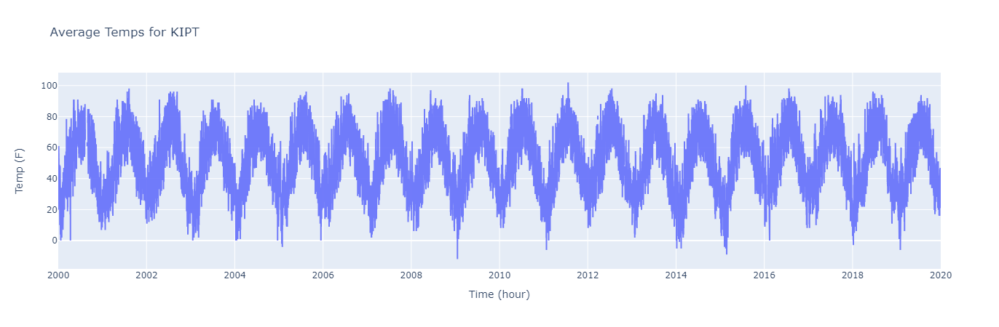

In [35]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=ipt.index,y=ipt,name = "KIPT", opacity = .9))
fig.update_layout(title_text = "Average Temps for KIPT",
                  xaxis_title = "Time (hour)",
                  yaxis_title = "Temp (F)")
fig.show()
#some values are 0 when they shouldn't be

### 21) [P] Compute a new Series that represents a running delta temperature between adjacent average temperature readings for KIPT. Then, plot the distribution of these data using whatever visualization you think characterizes this distribution best.
(HINT: It's a series of observations over a single numeric variable. What
type of plot can reveal the distribution of these data?)

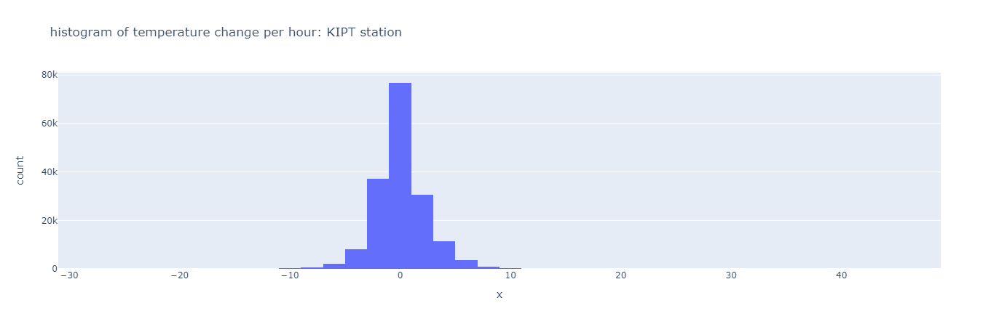

In [48]:
iptDelta = ipt.diff()
px.histogram(x = iptDelta, nbins = 45,title = "histogram of temperature change per hour: KIPT station")

### 22) [P] Perhaps it's more important to select the station that has the most similar values. Write a function called compare_station that takes two Series objects of numeric data, and computes the sum of the absolute value of the difference between each pair of numbers in both Series. You should only sum the values that have valid values for both entries. Return the average of these absolute differences. Then, call compare_station on KIPT and each of the new station, but pass only the average temp vector from each station using your df_ave_temps

In [50]:
def compare_station(stat1,stat2):
    statDelta = stat1.sub(stat2).abs() # get delta for each hour
    validIndices = (stat1.notna()) & (stat2.notna()) # find which hours are not na for both
    validStatDelta = statDelta[validIndices] #only use these hours 
    statDeltaSum = validStatDelta.sum() #sum all deltas
    statDeltaAvg = statDeltaSum / len(validStatDelta) # divide sum by count of valid deltas to get avg
    return statDeltaAvg
    
# avg temp vectors already defined in ipt, unv, seg, cxy variables
print("KIPT and KCXY ave temp Diff: ",compare_station(ipt,cxy))
print("KIPT and KSEG ave temp Diff: ",compare_station(ipt,seg))
print("KIPT and KUNV ave temp Diff: ",compare_station(ipt,unv))

KIPT and KCXY ave temp Diff:  3.711851475076297
KIPT and KSEG ave temp Diff:  2.064187684478521
KIPT and KUNV ave temp Diff:  3.0005328667210294


### 23) [P] As we learned in class, you could compute a correlation coefficient between columns of data to determine similarity. Compute the correlation coefficient between the average temp of KIPT, and each of the other stations you downloaded. They should all be very close to 1, but not quite. What does this technique suggest which station is most similar?

In [51]:
print("KIPT and KCXY ave temp correlation: ",ipt.corr(cxy))
print("KIPT and KUNV ave temp correlation: ",ipt.corr(unv))
print("KIPT and KSEG ave temp correlation: ",ipt.corr(seg))
#all stations are similar but KSEG is most similar to KIPT

KIPT and KCXY ave temp correlation:  0.9811627952460058
KIPT and KUNV ave temp correlation:  0.9799060448866617
KIPT and KSEG ave temp correlation:  0.9883294651671236


### 24) [M] Interpret what you have observed so far. Which station is most similar? How would this affect your approach to cleaning your data? Are there other things you might do to clean your data?

KSEG is most similar. When trying to find substitute values for KIPT where it is missing, I could use values from KSEG. There are many other ways we could clean our data. Possibly we could average the temps of all stations that had a value when KIPT didn't and weight them by distance to KIPT. "distance" in this case could mean on a map, or distance in terms of how closely correlated they are or how different their same-hour values are on average.

### 25) [P] Create a new attribute called KIPT_GOOD in your df_ave_temps data frame that keeps all of the original average temp data, but takes the readings from the closest station with available data to replace in the NA values. Be sure to replace the data from the best representative first, then the second best. Ignore the third. When you perform data cleaning, NEVER DELETE YOUR ORIGINAL DATA! Either store it, or just create a separate attribute of cleaned data, or create a separate data frame. AND, be sure to print out what you are doing. Be sure to include a before and after view to indicate how many values you fixed. For example:

In [76]:
#put KIPT in new column
df_ave_temps["KIPT_GOOD"] = ipt
iptGood = df_ave_temps["KIPT_GOOD"]
#see how many NA we start with
firstNumNA = iptGood.isna().sum()
print("Starting with {} missing values in KIPT".format(firstNumNA))

#put KSEG values where we can in new column
iptGood.fillna(value = seg, inplace =True)
#calculate how mayn na we filled
secondNumNA = iptGood.isna().sum()
print("Copied {} values from KSEG".format(firstNumNA - secondNumNA))

#put KUNV values where we can in new column
iptGood.fillna(value = unv, inplace =True)
#calculate how mayn na we filled
thirdNumNA = iptGood.isna().sum()
print("Copied {} values from KUNV".format(secondNumNA - thirdNumNA))
print("Still {} missing values in KIPT".format(iptGood.isna().sum()))

Starting with 3067 missing values in KIPT
Copied 1505 values from KSEG
Copied 329 values from KUNV
Still 1233 missing values in KIPT


### 26) [P] How many missing values left in KIPT_GOOD are "singletons", i.e. a missing value surrounded by two good observations?

In [77]:
surrByNotNA = iptGood[(iptGood.shift().notna()) & (iptGood.shift(periods = -1).notna())] # compare to shifted up 1 and back 1 
surrByNotNA.isna().sum() # get # of values in this series that are na

147

### 27) [P] Go through the variable KIPT_GOOD, and convert all singletons to an average of the surrounding observations. For example [..., 2, Nan, 5, ...] would be filled in with (2+5)/2 = 3.5. Then, report the number of values that are still missing in KIPT_GOOD.

In [87]:
replacer = (iptGood.shift() + iptGood.shift(-1)) /2
iptGood.fillna(replacer,inplace = True)
print("{} values still missing in KIPT".format(iptGood.isna().sum()))

1086 values still missing in KIPT


### 28) [P] Eliminate that first year of data from df_ave_temps. There are too many missing values in these data to make it worthwhile.

In [88]:
df_ave_temps = df_ave_temps[df_ave_temps.index.year != 2000]

### 29) [P] Generate a final report of the total number of missing values in df_ave_temps.KIPT_GOOD by year.

In [91]:
df_ave_temps.KIPT_GOOD.isna().resample("Y").sum()

2001-12-31 00:00:00+00:00    11.0
2002-12-31 00:00:00+00:00     0.0
2003-12-31 00:00:00+00:00    11.0
2004-12-31 00:00:00+00:00     2.0
2005-12-31 00:00:00+00:00     5.0
2006-12-31 00:00:00+00:00     3.0
2007-12-31 00:00:00+00:00    30.0
2008-12-31 00:00:00+00:00    90.0
2009-12-31 00:00:00+00:00    15.0
2010-12-31 00:00:00+00:00     6.0
2011-12-31 00:00:00+00:00    10.0
2012-12-31 00:00:00+00:00    18.0
2013-12-31 00:00:00+00:00    21.0
2014-12-31 00:00:00+00:00     5.0
2015-12-31 00:00:00+00:00    20.0
2016-12-31 00:00:00+00:00     6.0
2017-12-31 00:00:00+00:00    52.0
2018-12-31 00:00:00+00:00    35.0
2019-12-31 00:00:00+00:00    15.0
Freq: A-DEC, Name: KIPT_GOOD, dtype: float64

### 30) [P] Finally, create some good, clean line plots of KIPT_GOOD. Create at least three plots using different averaging times. One should be the raw data. Create one by month. Then, create one by year. Be sure they are labeled.
Congratulations! Between this lab and the previous lab, you gained a taste of what life is like as a data munger!

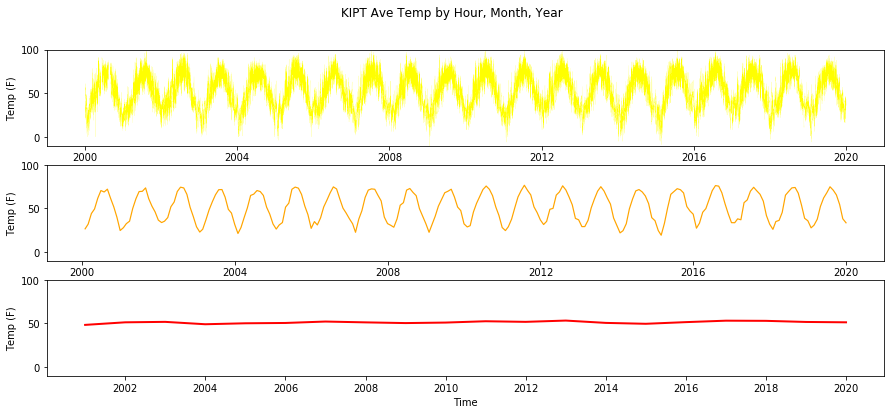

In [115]:
iptGoodMonth = iptGood.resample('M').mean()
iptGoodYear = iptGood.resample('Y').mean()
fig, axs = plt.subplots(3,figsize = (15,6))
fig.suptitle("KIPT Ave Temp by Hour, Month, Year")
plt.setp(axs, ylabel = "Temp (F)",xlabel ="Time",ylim = (-10,100)) 
axs[0].plot(iptGood,c = "yellow",linewidth = .1)
axs[1].plot(iptGoodMonth, c = "orange",linewidth = 1.2)
axs[2].plot(iptGoodYear, c= "red",linewidth = 2)
plt.show()